## CIND820 Project Course Code
#### Ryan Boyd - 501072988
### Assignment 3
### Initial Results and Code

In [1]:
#import all libraries
import laspy as lp, sklearn as skl, numpy as np, matplotlib as mp, pandas as pd

In [2]:
from sklearn import cluster
from sklearn import preprocessing as prep
from sklearn.neighbors import NearestNeighbors
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV

In [3]:
import matplotlib.pyplot as plt

In [4]:
import PIL
from PIL import ImageStat as istat
from PIL import ImageOps

#### Data is loaded and prepared

In [5]:
#original dataset https://nrs.objectstore.gov.bc.ca/gdwuts/092/092g/2016/dsm/bc_092g025_3_4_2_xyes_8_utm10_20170601_dsm.laz
#renamed here for clarity
path_to_data = "F:/Data/Lidar/dtvan/dtvan.laz"
with lp.open(path_to_data) as las_file:
    las_data = las_file.read()

In [6]:
# data loaded into a dataframe
df = pd.DataFrame({"X":list(las_data.x),"Y":list(las_data.y),"Z":list(las_data.z),"Intensity":las_data.intensity,"return_num":las_data.return_number,"totalreturns":las_data.num_returns,"classification":las_data.classification})

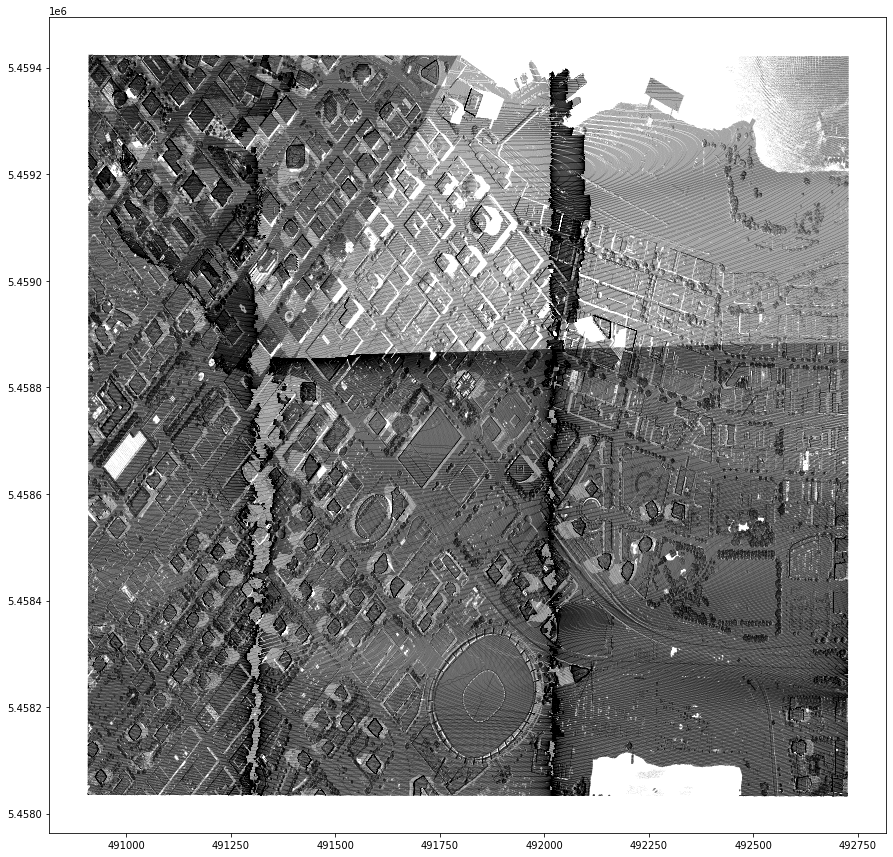

In [7]:
#full dataset displayed on a scatter plot
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(df['X'],df['Y'],zorder=1,alpha=0.25,c='black',s=0.001)

In [8]:
print("Total points:" + str(las_data.header.point_count))

Total points:20975490


In [9]:
#print("Classes: " + str(set(list(df['classification']))))

In [10]:
#data summary
df.describe()

,X,Y,Z,Intensity,return_num,totalreturns,classification
count,2.097549e+07,2.097549e+07,2.097549e+07,2.097549e+07,2.097549e+07,2.097549e+07,2.097549e+07
mean,4.917468e+05,5.458670e+06,3.049814e+01,8.719158e+01,1.089610e+00,1.179469e+00,1.096450e+00
std,5.265176e+02,3.876956e+02,2.793111e+01,8.505020e+01,3.125447e-01,4.422535e-01,2.952076e-01
min,4.909066e+05,5.458034e+06,-9.260000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
25%,4.912811e+05,5.458337e+06,1.176000e+01,4.700000e+01,1.000000e+00,1.000000e+00,1.000000e+00
50%,4.917073e+05,5.458645e+06,2.478000e+01,6.700000e+01,1.000000e+00,1.000000e+00,1.000000e+00
75%,4.921687e+05,5.458984e+06,3.776000e+01,1.020000e+02,1.000000e+00,1.000000e+00,1.000000e+00
max,4.927268e+05,5.459425e+06,2.330600e+02,4.064000e+03,5.000000e+00,5.000000e+00,2.000000e+00


#### The full original dataset is too large to work with so it is clipped to a smaller study area. The dataframe is queried by the study area longitude and latitude boundary. The pre-classified ground points, class 2, are removed (since we are not concerned with ground right now), class 1 are the unclassified points and we only want to work with these.

In [11]:
# Define the area of interest, these values in meters are in the "NAD83 UTM 10" coordinate system of the provided dataset
# These are the upper and lower limits in meters to be used, these can be found using google maps or other free sites/software
# These were selected somewhat arbitrarily
aoi_extent = {'xmax':492349.0731766,'xmin':492043.6935073,'ymax':5458645.8660691,'ymin':5458340.4864470}

In [12]:
#query the dataframe to return only the points within the extent above and remove the points defined as ground as well
df_clip = df.query("X>{0}&X<{1}&Y>{2}&Y<{3}&classification==1".format(aoi_extent['xmin'],aoi_extent['xmax'],aoi_extent['ymin'],aoi_extent['ymax']))

In [13]:
df_clip

,X,Y,Z,Intensity,return_num,totalreturns,classification
4394229,492044.02,5458475.09,18.75,27,2,2,1
4394231,492044.00,5458475.08,18.74,26,2,2,1
4394233,492043.98,5458475.08,18.75,26,2,2,1
4394235,492043.94,5458475.08,18.78,32,2,2,1
4394237,492043.91,5458475.08,18.75,41,2,2,1
...,...,...,...,...,...,...,...
20825059,492345.70,5458600.09,15.56,153,1,1,1
20825060,492345.82,5458600.05,14.90,116,1,1,1
20825061,492346.11,5458600.05,14.84,139,1,1,1
20825062,492346.34,5458600.04,14.50,66,1,2,1


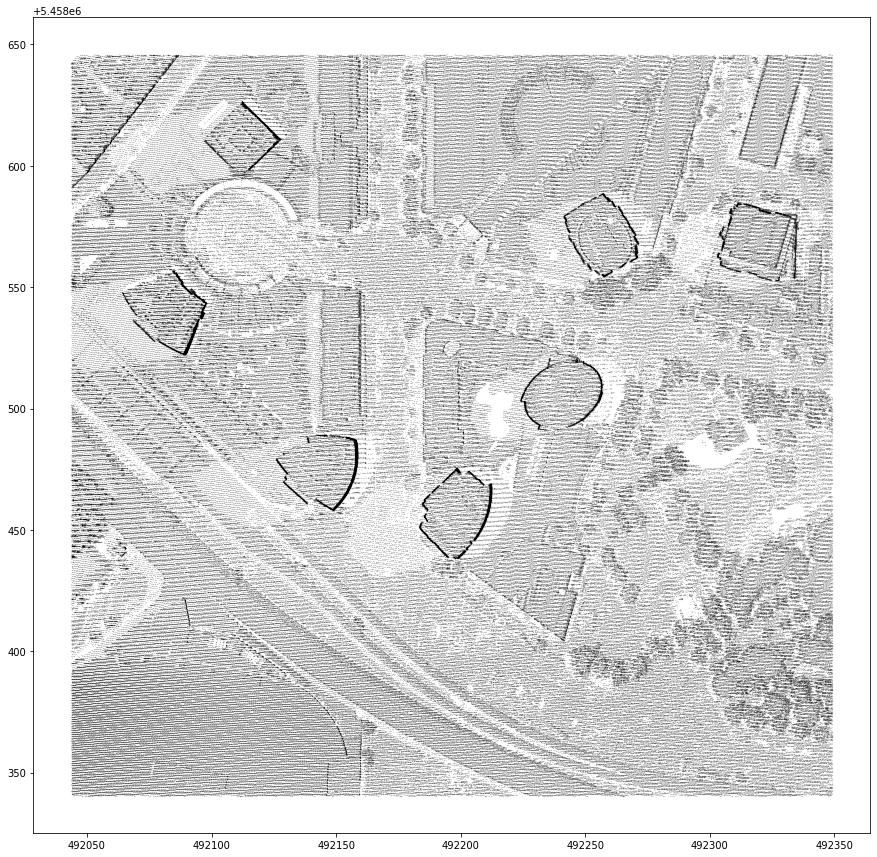

In [14]:
#study area points displayed on a scatter plot
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(df_clip['X'],df_clip['Y'],zorder=1,alpha=0.5,c='black',s=0.01)

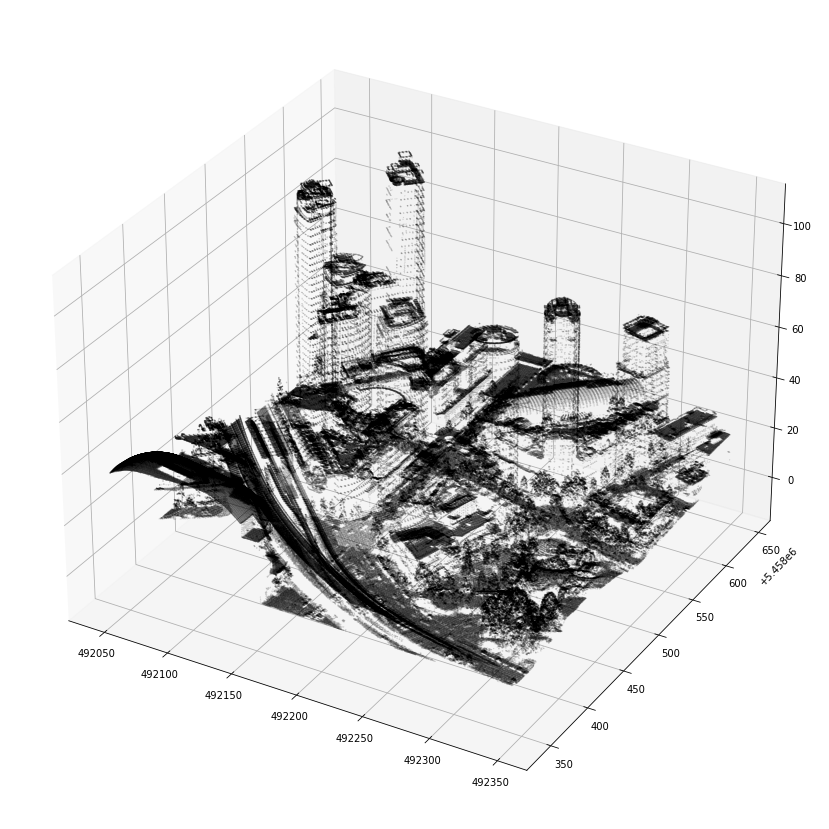

In [15]:
#the height is used value to visualize in 3d, since the values are in meters for all 3 axes, it plots nicely as is
fig,ax = plt.subplots(figsize = (15,15)),plt.axes(projection='3d')
ax.scatter3D(df_clip['X'],df_clip['Y'],df_clip['Z'],c='black',s=0.01,alpha=0.5)

#from matplotlib import cm
#ax.plot_surface(df_clip['X'],df_clip['Y'],df_clip['Z'],cmap=cm.coolwarm,linewidth=0,antialiased=False)

In [16]:
# The Z values are an absolute elevation which is not as useful as height relative to the ground
df_ground = df.query("X>{0}&X<{1}&Y>{2}&Y<{3}&classification==2".format(aoi_extent['xmin'],aoi_extent['xmax'],aoi_extent['ymin'],aoi_extent['ymax']))

In [34]:
df_ground['Z']
# I need to create a ground image used to subtract from the elevation(Z) in order to get the height of the points relative to the ground

6437554     5.20
6441448     5.39
6441451     5.25
6441453     5.24
6441456     5.26
            ... 
20822410    5.51
20822411    5.49
20822412    5.50
20822414    5.52
20822415    5.53
Name: Z, Length: 75058, dtype: float64

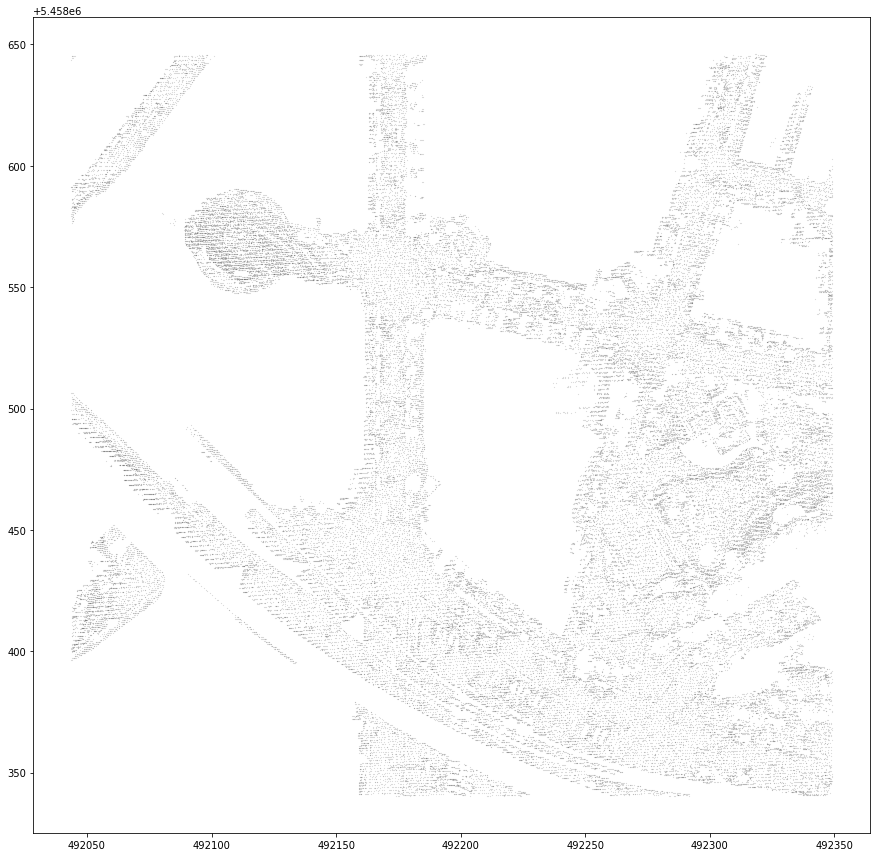

In [305]:
# Plotting the pre classified/labelled ground points for reference
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(df_ground['X'],df_ground['Y'],c='black',s=0.01,alpha=0.5)

In [36]:
df_ground

,X,Y,Z,Intensity,return_num,totalreturns,classification
6437554,492162.55,5458342.03,5.20,79,1,1,2
6441448,492177.73,5458340.96,5.39,84,1,1,2
6441451,492176.85,5458341.06,5.25,85,1,1,2
6441453,492176.29,5458341.13,5.24,62,1,1,2
6441456,492175.47,5458341.22,5.26,49,1,1,2
...,...,...,...,...,...,...,...
20822410,492326.01,5458600.33,5.51,80,1,1,2
20822411,492326.32,5458600.34,5.49,85,1,1,2
20822412,492326.64,5458600.36,5.50,109,1,1,2
20822414,492327.25,5458600.38,5.52,131,1,1,2


In [17]:
df_all = df.query("X>{0}&X<{1}&Y>{2}&Y<{3}".format(aoi_extent['xmin'],aoi_extent['xmax'],aoi_extent['ymin'],aoi_extent['ymax']))

In [194]:
vegetation = df_all.query("return_num < totalreturns & totalreturns > 1")

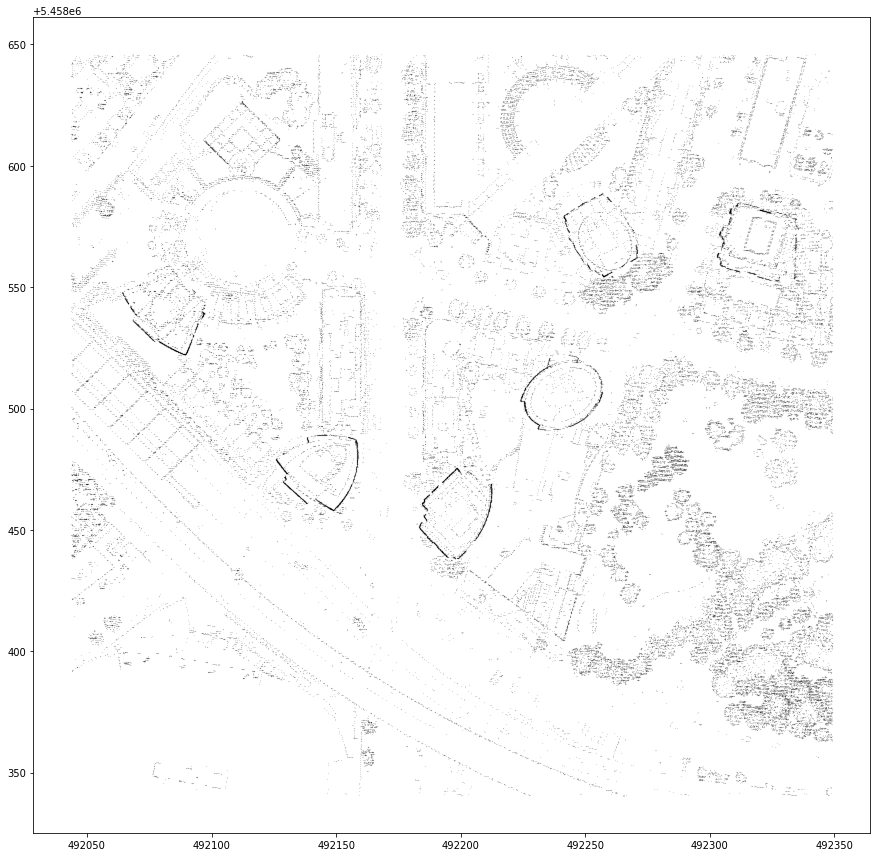

In [195]:
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(vegetation['X'],vegetation['Y'],zorder=1,alpha=0.5,c='black',s=0.01)

In [152]:
train,test = train_test_split(df_all)

In [159]:
X_train = pd.DataFrame({"Intensity":train['Intensity'],"return_num":train['return_num'],"totalreturns":train['totalreturns'],"Z":train['Z']})

In [160]:
y_train = np.ravel(pd.DataFrame({"classification":train['classification']}))

In [161]:
X_test = pd.DataFrame({"Intensity":test['Intensity'],"return_num":test['return_num'],"totalreturns":test['totalreturns'],"Z":test['Z']})

In [162]:
y_test = np.ravel(pd.DataFrame({"classification":test['classification']}))

In [165]:
model = RandomForestClassifier(max_depth=2,random_state=0,n_estimators=100,criterion="entropy",verbose=0,class_weight="balanced")

In [166]:
fit = model.fit(X_train,y_train)

In [167]:
len([i for i in fit.predict(X_test) if i != 1])

72235

In [168]:
fit.score(X_test,y_test)

0.7516323234753798

In [169]:
table = pd.DataFrame({"Intensity":df_all['Intensity'],"return_num":df_all['return_num'],"totalreturns":df_all['totalreturns'],"Z":df_all['Z']})

In [170]:
prediction = fit.predict(table)

In [171]:
len([i for i in prediction if i == 1])

576004

In [172]:
len([i for i in prediction if i != 1])

288408

In [173]:
df_all['prediction'] = prediction.tolist()

<ipython-input-173-d90987e474e1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_all['prediction'] = prediction.tolist()


In [174]:
df_all.query("classification != prediction")

,X,Y,Z,Intensity,return_num,totalreturns,classification,prediction
6430206,492161.40,5458340.54,5.36,75,2,2,1,2
6430207,492161.67,5458340.51,5.35,98,1,1,1,2
6434045,492167.22,5458340.51,5.36,39,1,1,1,2
6434046,492166.95,5458340.54,5.32,41,1,1,1,2
6434047,492166.67,5458340.57,5.31,50,1,1,1,2
...,...,...,...,...,...,...,...,...
20822423,492330.03,5458600.47,5.59,65,1,1,1,2
20822497,492348.80,5458601.35,9.26,97,1,1,1,2
20822498,492349.07,5458601.34,9.08,115,1,1,1,2
20824938,492348.84,5458600.15,9.02,91,1,1,1,2


In [181]:
predicted_ground = df_all.query("prediction == 2")

In [182]:
predicted_ground

,X,Y,Z,Intensity,return_num,totalreturns,classification,prediction
6430206,492161.40,5458340.54,5.36,75,2,2,1,2
6430207,492161.67,5458340.51,5.35,98,1,1,1,2
6434045,492167.22,5458340.51,5.36,39,1,1,1,2
6434046,492166.95,5458340.54,5.32,41,1,1,1,2
6434047,492166.67,5458340.57,5.31,50,1,1,1,2
...,...,...,...,...,...,...,...,...
20822423,492330.03,5458600.47,5.59,65,1,1,1,2
20822497,492348.80,5458601.35,9.26,97,1,1,1,2
20822498,492349.07,5458601.34,9.08,115,1,1,1,2
20824938,492348.84,5458600.15,9.02,91,1,1,1,2


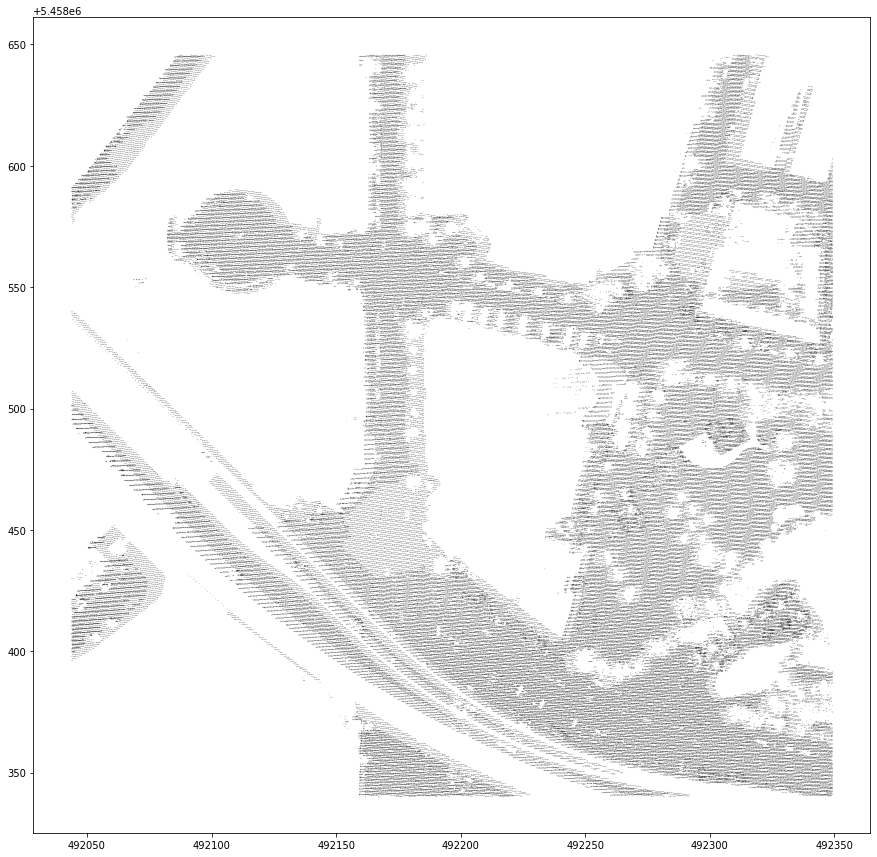

In [183]:
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(predicted_ground['X'],predicted_ground['Y'],zorder=1,alpha=0.5,c='black',s=0.01)

In [189]:
predicted_non_ground = df_all.query("prediction == 1")

In [307]:
df_clip = predicted_non_ground

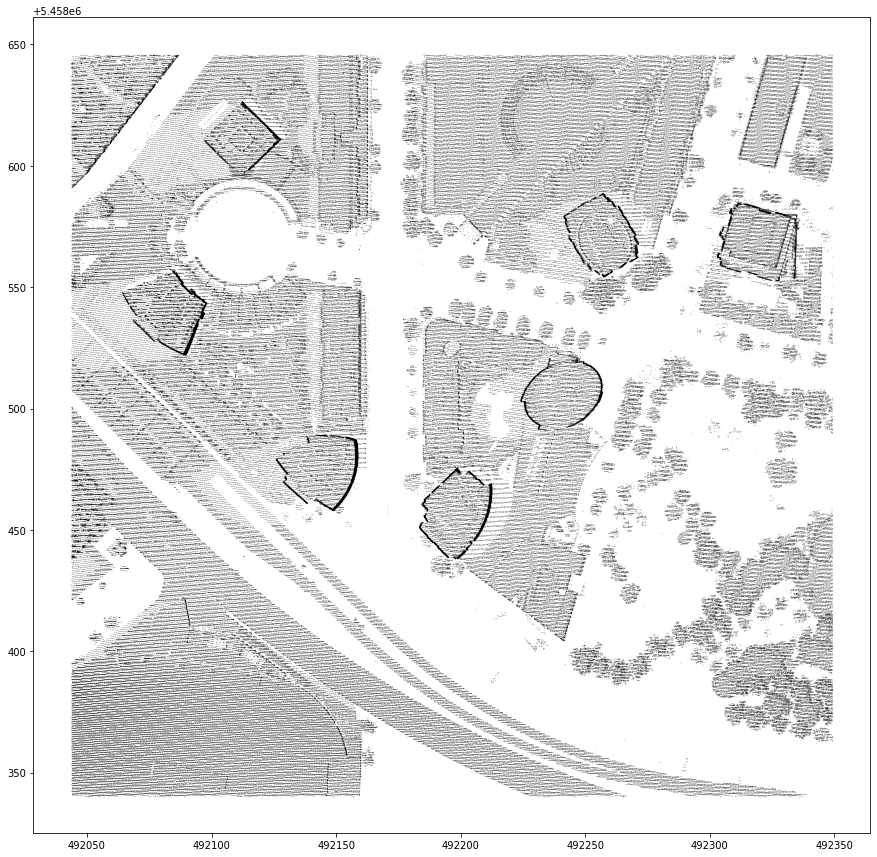

In [308]:
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(predicted_non_ground['X'],predicted_non_ground['Y'],zorder=1,alpha=0.5,c='black',s=0.01)

#### Data normalized and preprocessed for analysis

In [309]:
x_normal = (df_clip['X'] - min(df_clip['X']))/(max(df_clip['X']-min(df_clip['X'])))

In [310]:
y_normal = (df_clip['Y'] - min(df_clip['Y']))/(max(df_clip['Y']-min(df_clip['Y'])))

In [311]:
z_normal = (df_clip['Z'] - min(df_clip['Z']))/(max(df_clip['Z']-min(df_clip['Z'])))

In [312]:
i_normal = (df_clip['Intensity'] - min(df_clip['Intensity']))/(max(df_clip['Intensity']-min(df_clip['Intensity'])))

In [313]:
# new dataframe containing all the normalized values is created
df_normal = pd.DataFrame({'X':x_normal,'Y':y_normal,'Z':z_normal,'I':i_normal,'return_num':df_clip['return_num'],'total_returns':df_clip['totalreturns']})

In [314]:
df_normal

,X,Y,Z,I,return_num,total_returns
4394229,0.001048,0.440777,0.113141,0.006407,2,2
4394231,0.000982,0.440744,0.113040,0.006161,2,2
4394233,0.000917,0.440744,0.113141,0.006161,2,2
4394235,0.000786,0.440744,0.113444,0.007639,2,2
4394237,0.000688,0.440744,0.113141,0.009857,2,2
...,...,...,...,...,...,...
20825059,0.988964,0.850116,0.080945,0.037457,1,1
20825060,0.989357,0.849985,0.074283,0.028339,1,1
20825061,0.990307,0.849985,0.073678,0.034007,1,1
20825062,0.991060,0.849953,0.070246,0.016018,1,2


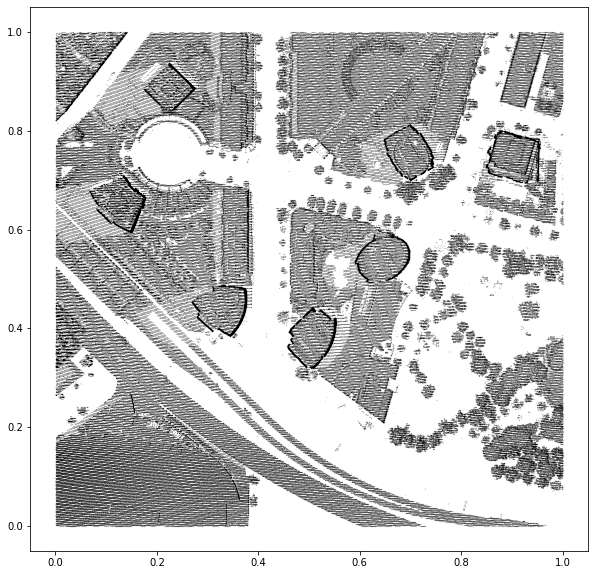

In [315]:
# Plotting normalized looks the same but with the new scale
fig,ax = plt.subplots(figsize = (10,10))
ax.scatter(df_normal['X'],df_normal['Y'],c='black',s=0.01,alpha=0.5)

## Add Imagery Data
#### 2015 Imagery data was obtained from the City of Vancouver to extract the RGB values
#### The image was clipped using external software (QGIS, open-source mapping program) to the same area of interest as above
#### The selected image size is 4084x4084, the lidar data is normalized by 4084 to extract the nearest pixel value(r,g,b) from the image for each point

In [316]:
image_path = "F:/Data/Lidar/images/BCVANC15_P9_aoiclip.tif"

In [317]:
img = PIL.Image.open(image_path)

In [318]:
rgb_img = img.convert("RGB")

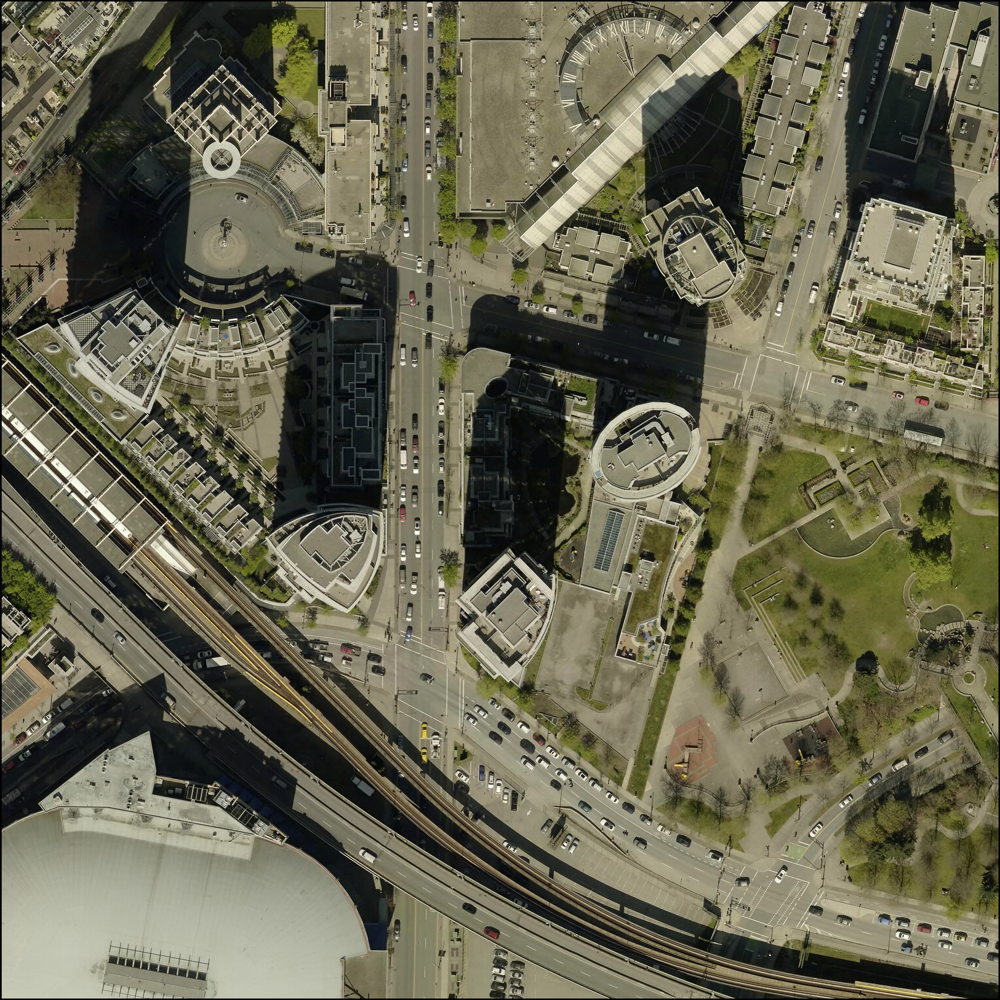

In [319]:
rgb_img

In [320]:
#this can be used to crop the imagery if we knew the exact coordinates, but I used QGIS to clip the imagery instead
#left,top,right,bottom = 0,0,4084,4084
#rgb_img = img.crop((left,top,right,bottom))

In [321]:
#import math
#math.sqrt(istat.Stat(rgb_img).count[0])

In [322]:
#this size aligns the pixels to the lidar points to extract the rgb values for each point
img.size

(4084, 4084)

In [323]:
#The image origin (top left) is different than the coordinate system of the lidar so the image needs to be flipped for the calculation to align them
rgb_img = PIL.ImageOps.flip(rgb_img)

In [324]:
#rgb_img.getpixel((2070,2070))

In [325]:
# rescales the point values to line up with the pixels in the imagery - same idea as normalization
# this is basically reprojecting the coordinates of the lidar points to the coordinates of the image
x_img = (df_clip['X'] - min(df_clip['X']))/(max(df_clip['X']-min(df_clip['X'])))*4083
y_img = (df_clip['Y'] - min(df_clip['Y']))/(max(df_clip['Y']-min(df_clip['Y'])))*4083

In [326]:
y_img

4394229     1799.691522
4394231     1799.557815
4394233     1799.557815
4394235     1799.557815
4394237     1799.557815
               ...     
20825059    3471.024659
20825060    3470.489832
20825061    3470.489832
20825062    3470.356125
20825063    3470.356125
Name: Y, Length: 576004, dtype: float64

In [327]:
coord_array = np.array(pd.DataFrame({"X":x_img,"Y":y_img}))

In [328]:
coord_array
# locations on the image to read the rgb values

array([[4.27861283e+00, 1.79969152e+03],
       [4.01119953e+00, 1.79955782e+03],
       [3.74378623e+00, 1.79955782e+03],
       ...,
       [4.04342283e+03, 3.47048983e+03],
       [4.04649808e+03, 3.47035613e+03],
       [4.05010816e+03, 3.47035613e+03]])

#### The nearest R,G,B pixel value from the image is extracted for each lidar point and the results are saved as a field in the data frame

In [329]:
rgb_data = []
rgb_data_r = []
rgb_data_g = []
rgb_data_b = []
for coord in coord_array:
    rgb=rgb_img.getpixel((coord[0],coord[1]))
    r=rgb[0]
    g=rgb[1]
    b=rgb[2]
    rgb_data.append(rgb)
    rgb_data_r.append(r)
    rgb_data_g.append(g)
    rgb_data_b.append(b)
df_normal['rgb'] = rgb_data
df_normal['r'] = rgb_data_r
df_normal['g'] = rgb_data_g
df_normal['b'] = rgb_data_b

In [330]:
df_normal

,X,Y,Z,I,return_num,total_returns,rgb,r,g,b
4394229,0.001048,0.440777,0.113141,0.006407,2,2,"(0, 0, 0)",0,0,0
4394231,0.000982,0.440744,0.113040,0.006161,2,2,"(0, 0, 0)",0,0,0
4394233,0.000917,0.440744,0.113141,0.006161,2,2,"(0, 0, 0)",0,0,0
4394235,0.000786,0.440744,0.113444,0.007639,2,2,"(0, 0, 0)",0,0,0
4394237,0.000688,0.440744,0.113141,0.009857,2,2,"(0, 0, 0)",0,0,0
...,...,...,...,...,...,...,...,...,...,...
20825059,0.988964,0.850116,0.080945,0.037457,1,1,"(132, 129, 105)",132,129,105
20825060,0.989357,0.849985,0.074283,0.028339,1,1,"(136, 131, 105)",136,131,105
20825061,0.990307,0.849985,0.073678,0.034007,1,1,"(135, 130, 101)",135,130,101
20825062,0.991060,0.849953,0.070246,0.016018,1,2,"(138, 134, 102)",138,134,102


In [331]:
vegetation = df_normal.query("return_num < total_returns & total_returns > 1")

In [332]:
vegetation = df_normal.query("r<0.5 & g>0.25")

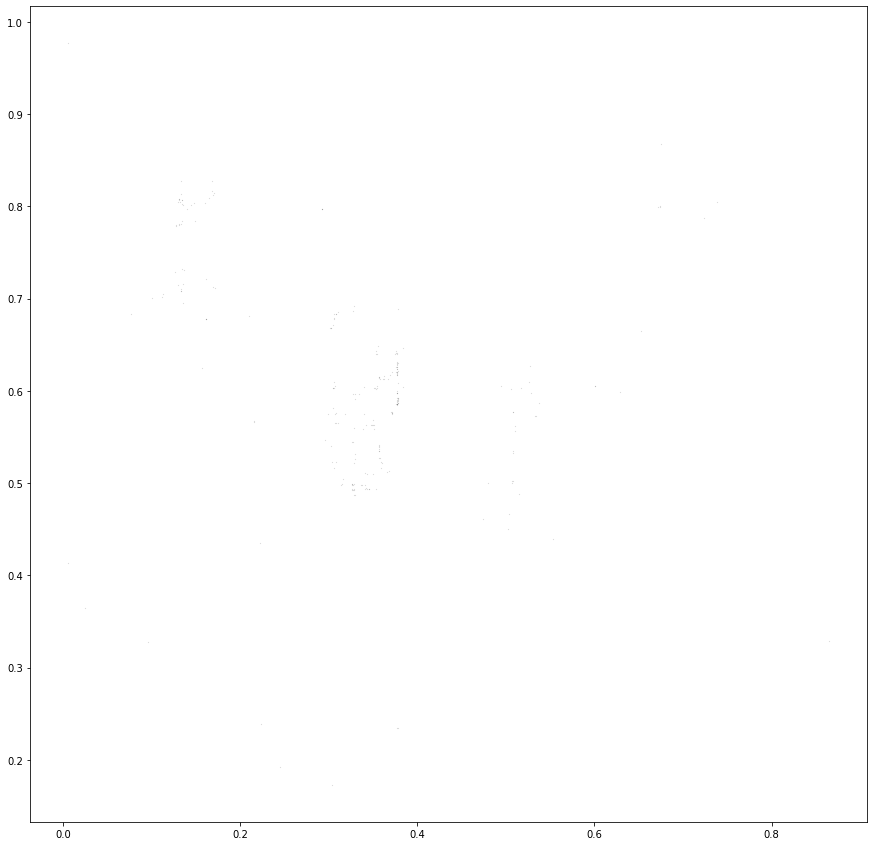

In [333]:
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(vegetation['X'],vegetation['Y'],zorder=1,alpha=0.5,c='black',s=0.01)

#### The R,G,B values are normalized like the rest:

In [334]:
r_normal = (df_normal['r'] - min(df_normal['r']))/(max(df_normal['r']-min(df_normal['r'])))
g_normal = (df_normal['g'] - min(df_normal['g']))/(max(df_normal['g']-min(df_normal['g'])))
b_normal = (df_normal['b'] - min(df_normal['b']))/(max(df_normal['b']-min(df_normal['b'])))
df_normal['r'] = r_normal
df_normal['g'] = g_normal
df_normal['b'] = b_normal

In [335]:
df_normal

,X,Y,Z,I,return_num,total_returns,rgb,r,g,b
4394229,0.001048,0.440777,0.113141,0.006407,2,2,"(0, 0, 0)",0.000000,0.000000,0.000000
4394231,0.000982,0.440744,0.113040,0.006161,2,2,"(0, 0, 0)",0.000000,0.000000,0.000000
4394233,0.000917,0.440744,0.113141,0.006161,2,2,"(0, 0, 0)",0.000000,0.000000,0.000000
4394235,0.000786,0.440744,0.113444,0.007639,2,2,"(0, 0, 0)",0.000000,0.000000,0.000000
4394237,0.000688,0.440744,0.113141,0.009857,2,2,"(0, 0, 0)",0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...
20825059,0.988964,0.850116,0.080945,0.037457,1,1,"(132, 129, 105)",0.517647,0.505882,0.413386
20825060,0.989357,0.849985,0.074283,0.028339,1,1,"(136, 131, 105)",0.533333,0.513725,0.413386
20825061,0.990307,0.849985,0.073678,0.034007,1,1,"(135, 130, 101)",0.529412,0.509804,0.397638
20825062,0.991060,0.849953,0.070246,0.016018,1,2,"(138, 134, 102)",0.541176,0.525490,0.401575


#### Dataset statistics and information - exploratory

In [336]:
#renaming the data frame for clarity
data = df_normal

(array([78482., 79516., 70813., 64857., 32918., 58757., 58348., 40610.,
        36179., 55524.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

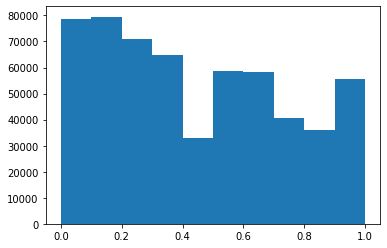

In [337]:
mp.pyplot.hist(data['X'])

(array([5.71645e+05, 2.78300e+03, 9.02000e+02, 3.01000e+02, 1.18000e+02,
        7.70000e+01, 3.20000e+01, 4.40000e+01, 3.50000e+01, 6.70000e+01]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

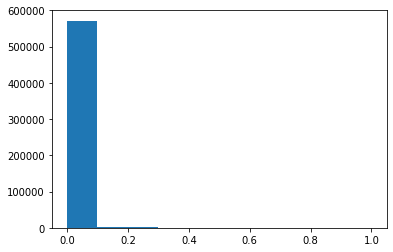

In [338]:
mp.pyplot.hist(data['I'])

(array([ 81450.,  53425.,  37341.,  50286.,  93920., 116107.,  66200.,
         56452.,  15694.,   5129.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

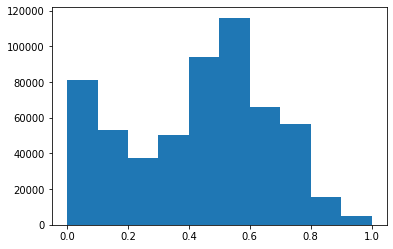

In [339]:
mp.pyplot.hist(data['r'])

In [340]:
#summarize the normalized data
data.describe()

,X,Y,Z,I,return_num,total_returns,r,g,b
count,576004.000000,576004.000000,576004.000000,576004.000000,576004.000000,576004.000000,576004.000000,576004.000000,576004.000000
mean,0.443462,0.515814,0.211602,0.025543,1.111803,1.261198,0.431835,0.423772,0.340057
std,0.294802,0.302500,0.215402,0.026219,0.339405,0.509798,0.235696,0.229488,0.212688
min,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000
25%,0.179029,0.231359,0.070246,0.013061,1.000000,1.000000,0.223529,0.219608,0.141732
50%,0.382618,0.532043,0.125050,0.019714,1.000000,1.000000,0.478431,0.462745,0.354331
75%,0.678226,0.791630,0.266350,0.033514,1.000000,1.000000,0.600000,0.584314,0.488189
max,1.000000,1.000000,1.000000,1.000000,5.000000,5.000000,1.000000,1.000000,1.000000


#### Additonal testing and improvements

#### Initial Classification (unsupervised) using kmeans clustering
#### Attempt to classify points into undetermined classes based on the data
##### Variables: Height, Intensity, R, G, B

In [341]:
features = pd.DataFrame({"R":df_normal['r'],"G":df_normal['g'],"B":df_normal['b'],"Z":df_normal['Z'],"I":df_normal['I']})

In [342]:
features

,R,G,B,Z,I
4394229,0.000000,0.000000,0.000000,0.113141,0.006407
4394231,0.000000,0.000000,0.000000,0.113040,0.006161
4394233,0.000000,0.000000,0.000000,0.113141,0.006161
4394235,0.000000,0.000000,0.000000,0.113444,0.007639
4394237,0.000000,0.000000,0.000000,0.113141,0.009857
...,...,...,...,...,...
20825059,0.517647,0.505882,0.413386,0.080945,0.037457
20825060,0.533333,0.513725,0.413386,0.074283,0.028339
20825061,0.529412,0.509804,0.397638,0.073678,0.034007
20825062,0.541176,0.525490,0.401575,0.070246,0.016018


In [343]:
X1 = np.array(features)

In [344]:
X1

array([[0.        , 0.        , 0.        , 0.1131409 , 0.0064071 ],
       [0.        , 0.        , 0.        , 0.11303997, 0.00616067],
       [0.        , 0.        , 0.        , 0.1131409 , 0.00616067],
       ...,
       [0.52941176, 0.50980392, 0.3976378 , 0.07367784, 0.0340069 ],
       [0.54117647, 0.5254902 , 0.4015748 , 0.07024627, 0.01601774],
       [0.55686275, 0.52941176, 0.42125984, 0.06933791, 0.00689995]])

In [345]:
# initialize model
kmeancluster = cluster.KMeans(5,init='random',n_init=10)

In [346]:
# fit to data
k_clusters = kmeancluster.fit(X1)

In [347]:
len(k_clusters.labels_)

576004

In [348]:
print("Number of clusters:" + str(len(np.unique(k_clusters.labels_))))
print("Points clustered: " + str(len([i for i in k_clusters.labels_ if i != -1])))

Number of clusters:5
Points clustered: 576004


In [349]:
#esults = results.query("db_cluster!=-1")

In [350]:
# add results to data frame
data['k_cluster'] = k_clusters.labels_

In [365]:
#rename for clarity again
results = data

#### Visualization

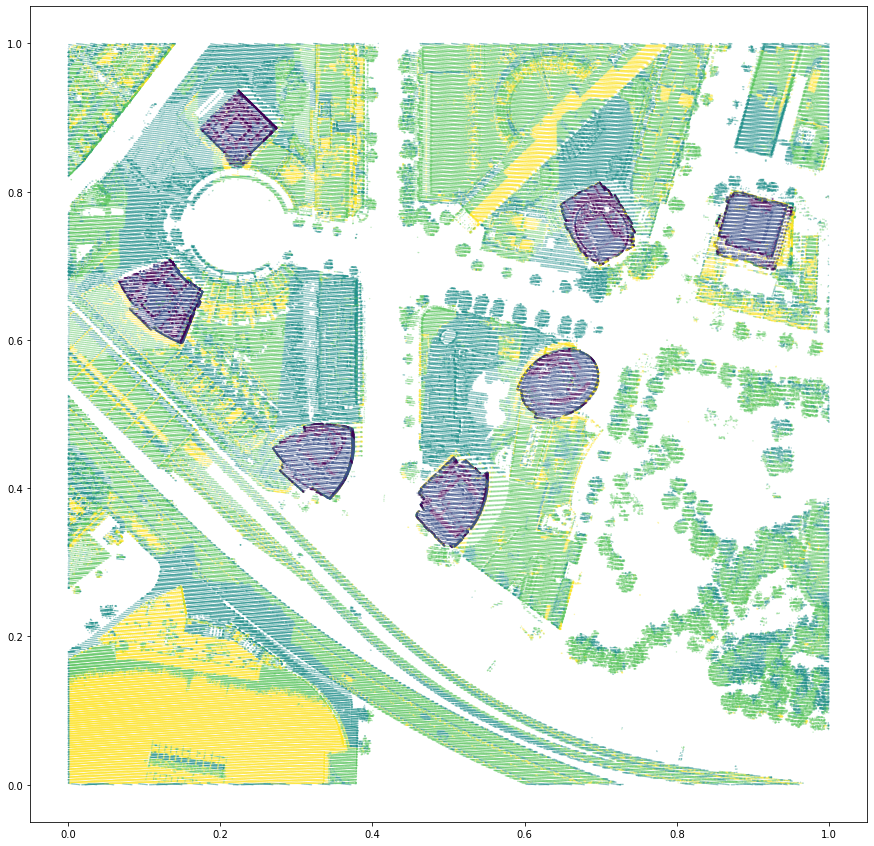

In [366]:
# visualize the classes
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(results['X'],results['Y'],c=results['k_cluster'],s=0.1,alpha=0.5)

In [367]:
colour_manip = pd.DataFrame()

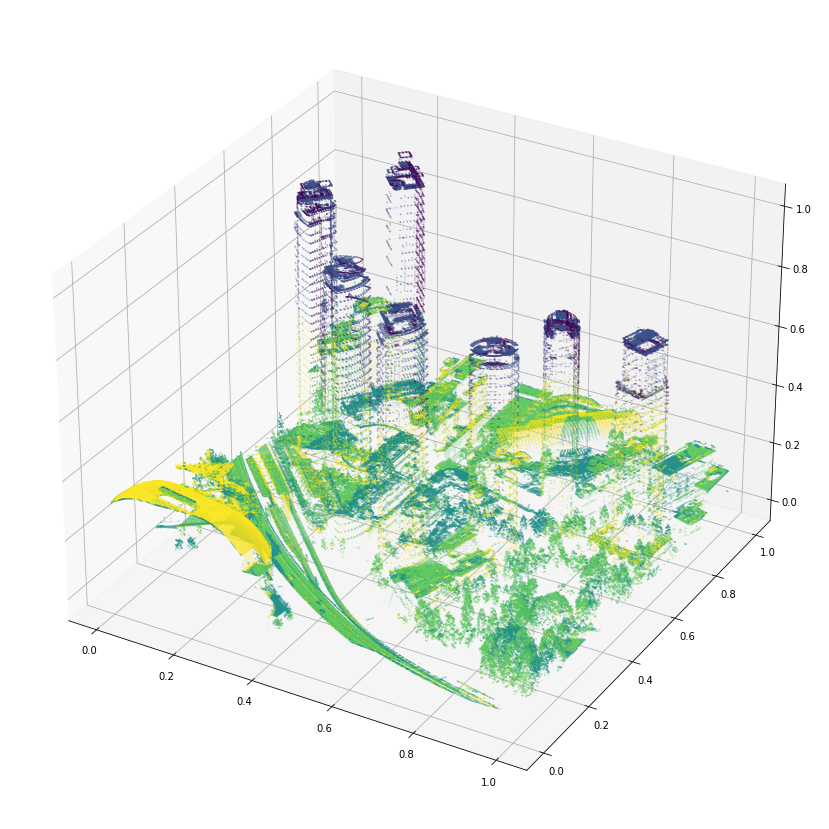

In [368]:
fig,ax = plt.subplots(figsize = (15,15)),plt.axes(projection='3d')
ax.scatter3D(data['X'],data['Y'],data['Z'],c=data['k_cluster'],s=0.01,alpha=1)

#### Spatial/Distance Clustering

#### This section will attempt to use the previous classificiation label to cluster the points into local distinct objects

In [393]:
df2 = pd.DataFrame({"X":data['X'],"Y":data['Y'],"Z":data['Z'],"k_cluster":data['k_cluster']})

In [394]:
X2 = np.array(df2)

In [395]:
X2

array([[1.04790909e-03, 4.40776763e-01, 1.13140896e-01, 2.00000000e+00],
       [9.82414775e-04, 4.40744015e-01, 1.13039968e-01, 2.00000000e+00],
       [9.16920457e-04, 4.40744015e-01, 1.13140896e-01, 2.00000000e+00],
       ...,
       [9.90306841e-01, 8.49985264e-01, 7.36778361e-02, 3.00000000e+00],
       [9.91060026e-01, 8.49952517e-01, 7.02462656e-02, 3.00000000e+00],
       [9.91944199e-01, 8.49952517e-01, 6.93379088e-02, 3.00000000e+00]])

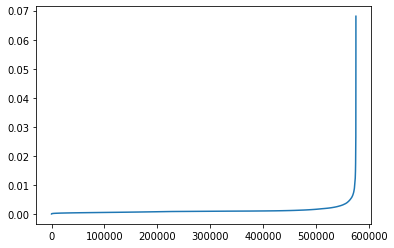

In [396]:
# to determine the value for the 'eps' parameter, the value of the inflection point on this distance graph is used
# this is the average distance between the points
nbr = NearestNeighbors(n_neighbors=2)
nbrs = nbr.fit(X2)
distances,indices = nbrs.kneighbors(X2)
distances = np.sort(distances,axis=0)
distances = distances[:,1]
plt.plot(distances)

In [415]:
dbscan = cluster.DBSCAN(eps=0.0075,min_samples=50,algorithm="auto",leaf_size=15,n_jobs=-1)

In [416]:
db_clusters = dbscan.fit(X2)

In [417]:
print("Number of clusters:" + str(len(np.unique(db_clusters.labels_))))
print("Points clustered: " + str(len([i for i in db_clusters.labels_ if i != -1])))

Number of clusters:732
Points clustered: 357087


In [418]:
#add cluster results to dataframe
results['db_cluster'] = db_clusters.labels_

In [419]:
#filter out results not clustered
results2 = results.query("db_cluster!=-1")

#### Visualization

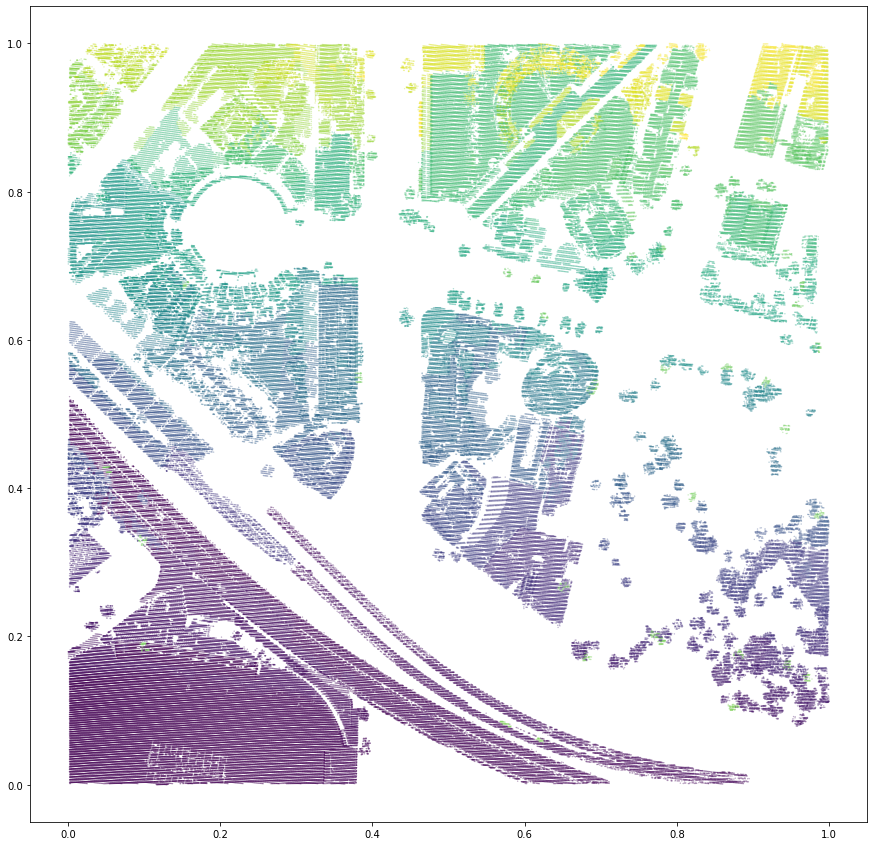

In [420]:
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(results2['X'],results2['Y'],c=results2['db_cluster'],s=0.1,alpha=0.5)

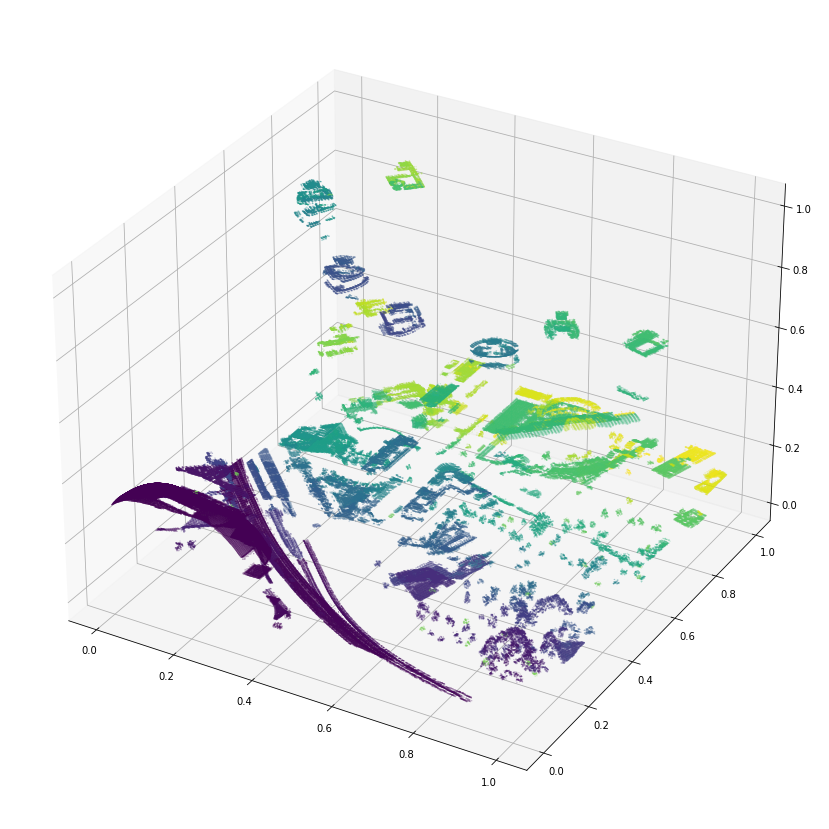

In [421]:
fig,ax = plt.subplots(figsize = (15,15)),plt.axes(projection='3d')
ax.scatter3D(results2['X'],results2['Y'],results2['Z'],c=results2['db_cluster'],s=0.01,alpha=1)

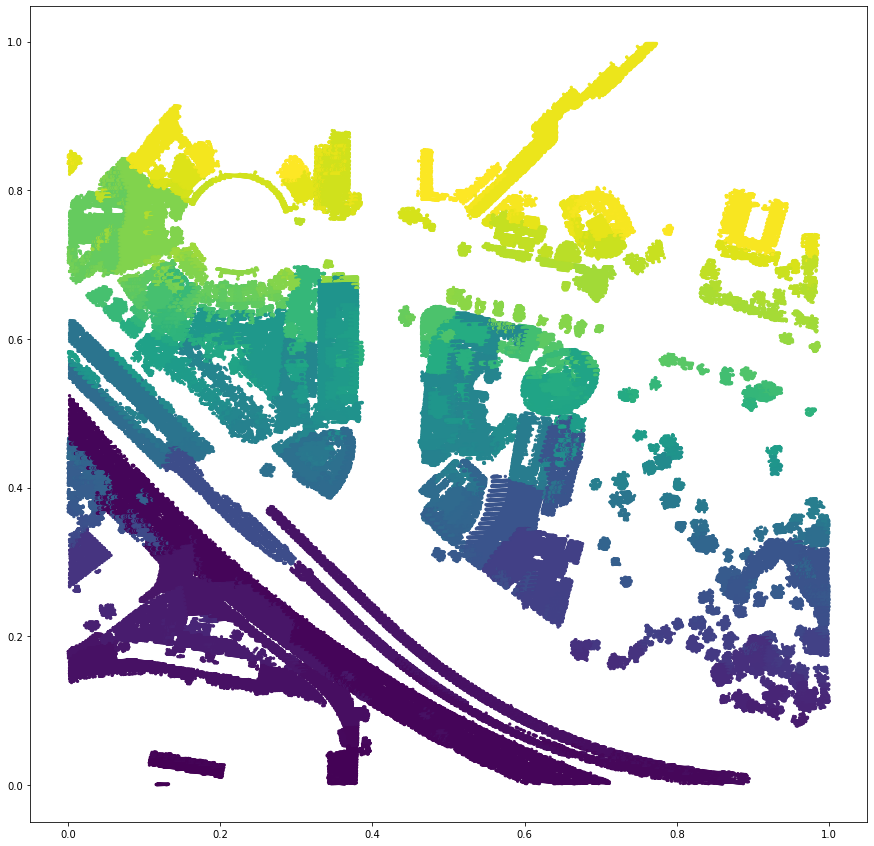

In [422]:
#looking at individual clusters which each should be equivalent to a unique/distinct "object"
result = results2.query("db_cluster<500&db_cluster>0")
fig,ax = plt.subplots(figsize = (15,15))
ax.scatter(result['X'],result['Y'],c=result['db_cluster'],s=5,alpha=1)

##### Testing Alternative models

In [ ]:
#optics = cluster.OPTICS(min_samples=10,max_eps=2,leaf_size=15)

In [ ]:
#op_clusters = optics.fit(X2)

In [ ]:
#len(set(db_clusters.labels_))
#results['op_clusters'] = op_clusters.labels_

#### Analysis of results

The elevation has a large effect on the classification and the R,G,B values from imagery causes the shadows to be very apparent, I may need to adjust the weighting of these values to mitigate issues. I will need to look into neighbourhood characteristics of groups of several points such as flat surfaces or planes and sharp edges, I did read about this in the research papers but it appears to be somewhat technically intensive for my purposes but I will investigate.



Next Steps:
-Optimize value of K for K-means, (elbow method or similar)
-Update the Z values to be a relative height to the ground as opposed to an absolute or (mean sea level) height.
-Optimize the parameters to improve results (eps,min_samples,leaf_size,etc.)
-Switch orthophoto for one without shadows
-Find method to extract clusters as features
-Create data for known features to compare
-Find method to compare results to known features
-Determine the evaluation criteria and minimum viable product
-Evaluate performance of models and project results overall

-supervised ground (from preclassified points)
    -random forest
    -
-supervised vegetation (from known points)
-grid search for parameters
-randomized forest/svm
-eigenvalues
-adjust or convert rgb values of the shadow class